# <font style="color:purple">Download the Dataset</font> 

**[Download the Vehicle registration plate](https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1)**


Download the Vehicle Registration Plate dataset from [here](https://www.dropbox.com/s/k81ljpmzy3fgtx9/Dataset.zip?dl=1) and unzip it. 

We will have the following directory structure:

```
Dataset
├── train
│   └── Vehicle registration plate
│       └── Label
└── validation
    └── Vehicle registration plate
        └── Label
```

Unzipping the file will give you a directory `Dataset`. This directory has two folder `train` and `validation`. Each train and validation folder has `Vehicle registration plate`  folder with `.jpg` images and a folder `Labels`.  `Labels` folder has bounding box data for the images.


For example,
For image: `Dataset/train/Vehicle registration plate/bf4689922cdfd532.jpg`
Label file is  `Dataset/train/Vehicle registration plate/Label/bf4689922cdfd532.txt`

There are one or more lines in each `.txt` file. Each line represents one bounding box.
For example,
```
Vehicle registration plate 385.28 445.15 618.24 514.225
Vehicle registration plate 839.68 266.066462 874.24 289.091462
```

We have a single class detection (`Vehicle registration plate detection`) problem. So bounding box details start from the fourth column in each row.

Representation is in `xmin`, `ymin`, `xmax`, and `ymax` format.

**It has `5308` training and `386` validation dataset.**

Data is downloaded from [Open Images Dataset](https://storage.googleapis.com/openimages/web/index.html)

#  <font style="color:green">1. Plot Ground Truth Bounding Boxes</font> 

**You have to show three images from validation data with the bounding boxes.**

The plotted images should be similar to the following:

<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-g1.png'>



<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-g2.png'>



<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-g3.png'>



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd /content/drive/MyDrive/'OpenCV Class 3 Project 3'

/content/drive/MyDrive/OpenCV Class 3 Project 3


In [ ]:
!apt-get install tree

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  tree
0 upgraded, 1 newly installed, 0 to remove and 37 not upgraded.
Need to get 40.7 kB of archives.
After this operation, 105 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tree amd64 1.7.0-5 [40.7 kB]
Fetched 40.7 kB in 0s (111 kB/s)
Selecting previously unselected package tree.
(Reading database ... 155047 files and directories currently installed.)
Preparing to unpack .../tree_1.7.0-5_amd64.deb ...
Unpacking tree (1.7.0-5) ...
Setting up tree (1.7.0-5) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...


In [ ]:
!tree -d ./Dataset

./Dataset
├── train
│   └── Vehicle registration plate
│       └── Label
└── validation
    └── Vehicle registration plate
        └── Label

6 directories


### Install PyCocoTools

In [3]:
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-gec75dzn
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-gec75dzn
  Created wheel for pycocotools: filename=pycocotools-2.0-cp37-cp37m-linux_x86_64.whl size=263918 sha256=66212bbb7ec201e3398f83d06100e7404b7c9112e8a79b456c99f4e14ef421a9
  Stored in directory: /tmp/pip-ephem-wheel-cache-tr4kx5ta/wheels/e2/6b/1d/344ac773c7495ea0b85eb228bc66daec7400a143a92d36b7b1
Successfully built pycocotools
  Attempting uninstall: pycocotools
    Found existing installation: pycocotools 2.0.2
    Uninstalling pycocotools-2.0.2:
      Successfully uninstalled pycocotools-2.0.2


### Install Detectron2

In [ ]:
!python -m pip install detectron2 -f   https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.9/index.html
  Created wheel for pycocotools: filename=pycocotools-2.0.2-cp37-cp37m-linux_x86_64.whl size=264007 sha256=e2bf5b818248d34282a149f490d8abcc16c24ceec27e937a28a278640f0b900b
  Stored in directory: /root/.cache/pip/wheels/bc/cf/1b/e95c99c5f9d1648be3f500ca55e7ce55f24818b0f48336adaf
Successfully built pycocotools
  Attempting uninstall: pycocotools
    Found existing installation: pycocotools 2.0
    Uninstalling pycocotools-2.0:
      Successfully uninstalled pycocotools-2.0


In [4]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-9fuddf0y
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-9fuddf0y
     |████████████████████████████████| 49 kB 4.5 MB/s 
     |████████████████████████████████| 74 kB 3.5 MB/s 
     |████████████████████████████████| 145 kB 29.0 MB/s 
     |████████████████████████████████| 130 kB 63.6 MB/s 
     |████████████████████████████████| 749 kB 55.7 MB/s 
     |████████████████████████████████| 843 kB 37.3 MB/s 
     |████████████████████████████████| 596 kB 72.3 MB/s 
     |████████████████████████████████| 112 kB 78.1 MB/s 
  Created wheel for detectron2: filename=detectron2-0.6-cp37-cp37m-linux_x86_64.whl size=5731482 sha256=1e01ab0136457950779f0bcf9e4048423695e79145646a78599e28e4e8787e17
  Stored in directory: /tmp/pip-ephem-wheel-cache-4ebp3pl9/wheels/07/dc/32/0322cb484dbefab8b9366bfedbaff5060ac7d149d69c27ca5d
  Created wheel for fvcore: filename=fvcore

In [ ]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Mon_Oct_12_20:09:46_PDT_2020
Cuda compilation tools, release 11.1, V11.1.105
Build cuda_11.1.TC455_06.29190527_0


In [5]:
import torch
print(torch.__version__, torch.cuda.is_available())

1.10.0+cu111 True


In [6]:
print(torch.cuda.is_available())
print(torch.cuda.current_device())
print(torch.cuda.get_device_name(0))

True
0
Tesla P100-PCIE-16GB


In [ ]:
!pip install torch==1.9.0 #torchvision==0.10.0+cu111 #-f https://download.pytorch.org/whl/torch_stable.html

     |████████████████████████████████| 831.4 MB 1.0 kB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.10.0+cu111
    Uninstalling torch-1.10.0+cu111:
      Successfully uninstalled torch-1.10.0+cu111
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchvision 0.11.1+cu111 requires torch==1.10.0, but you have torch 1.9.0 which is incompatible.
torchtext 0.11.0 requires torch==1.10.0, but you have torch 1.9.0 which is incompatible.


In [ ]:
!ls -d /usr/local/cuda-*

/usr/local/cuda-10.0  /usr/local/cuda-11    /usr/local/cuda-11.1
/usr/local/cuda-10.1  /usr/local/cuda-11.0


In [7]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import torch
import numpy as np
import cv2
import random
import os
import matplotlib.pyplot as plt

# model_zoo has lots of pre-trained models
from detectron2 import model_zoo

# DefaultTrainer is a class for training object detector
from detectron2.engine import DefaultTrainer
# DefaultPredictor is class for inference
from detectron2.engine import DefaultPredictor

# detectron2 has its configuration format
from detectron2.config import get_cfg
# detectron2 has implemented Visualizer of object detection
from detectron2.utils.visualizer import Visualizer

# from DatasetCatalog, detectron2 gets dataset and from MetadatCatalog it gets metadata of the dataset
from detectron2.data import DatasetCatalog, MetadataCatalog

# BoxMode supports bounding boxes in different format
from detectron2.structures import BoxMode

# COCOEvaluator based on COCO evaluation metric, inference_on_dataset is used for evaluation for a given metric
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

# build_detection_test_loader, used to create test loader for evaluation
from detectron2.data import build_detection_test_loader

In [8]:
%matplotlib inline

### Format Data for Detectron2

In [9]:
train_data_root = '/Dataset/train/Vehicle registration plate'
val_data_root = '/Dataset/validation/Vehicle registration plate'
ext = '.jpg'

train_data_name = 'Vehicle_registration_train'
test_data_name = 'Vehicle_registration_test'

### Register Dataset

In [10]:
train_data_root = './Dataset/train/Vehicle registration plate'
val_data_root = './Dataset/validation/Vehicle registration plate'

train_data_name = 'license_plate_train'
val_data_name = 'license_plate_validation'

thing_classes = ['license-plates']

output_dir = 'outputs'


def count_files(data_root):
  count = 0
  for filename in os.listdir(data_root):
    if filename.endswith('.jpg'):
      count = count + 1
  return count

train_img_count = count_files(train_data_root)
print(train_img_count)

5326


In [11]:
def get_license_plate_dicts(data_root):
  dataset_dicts = []
  filenames = []
  count = 0

  ext = '.jpg'

  for filename in os.listdir(data_root):
    if filename.endswith(ext):
      filenames.append(filename)

  for idx, filename in enumerate(filenames):
    record = {}
    
    image_path = os.path.join(data_root, filename)
    print(image_path)

    height, width = cv2.imread(image_path).shape[:2]
    count = count + 1
    print("Height: {}, Width: {}. Filename: {}, Count: {}".format(height, width, filename, count))

    record['file_name'] = image_path
    record['image_id'] = idx
    record['height'] = height
    record['width'] = width

    image_filename = os.path.basename(filename)
    image_name_split = filename.split('.')[0]
    image_name = image_name_split.split(' ')[0]
    annotation_path = os.path.join(data_root, 'Label', '{}.txt'.format(image_name))
    annotation_rows = []

    with open(annotation_path, "r") as f:
            for line in f:
                temp = line.rstrip().split(" ")
                annotation_rows.append(temp)

    objs = []
    for row in annotation_rows:
        #xcentre = int(float(row[3]))
        #ycentre = int(float(row[4]))
        #bwidth = int(float(row[5]))
        #bheight = int(float(row[6]))

        x1 = int(float(row[3]))
        x2 = int(float(row[4]))
        y1 = int(float(row[5]))
        y2 = int(float(row[6]))

        #xmin = int(xcentre - bwidth/2)
        #ymin = int(ycentre - bheight/2)
        #xmax = xmin  + bwidth
        #ymax = ymin + bheight
    
        obj= {
            #'bbox': [xmin, ymin, xmax, ymax],
            'bbox': [x1, x2, y1, y2],
            'bbox_mode': BoxMode.XYXY_ABS,
            # alternatively, we can use bbox_mode = BoxMode.XYWH_ABS
            # 'bbox': [xmin, ymin, bwidth, bheight],
            # 'bbox_mode': BoxMode.XYWH_ABS,
            'category_id': int(0),
            'iscrowd': 0
        }
    
        objs.append(obj)
    record['annotations'] = objs
    dataset_dicts.append(record)
  return dataset_dicts

In [12]:
# register test data
DatasetCatalog.register(name=train_data_name,
                        func=lambda: get_license_plate_dicts(train_data_root))
train_metadata = MetadataCatalog.get(train_data_name).set(thing_classes=thing_classes)

# register validation data
DatasetCatalog.register(name=val_data_name,
                        func=lambda: get_license_plate_dicts(val_data_root))
val_metadata = MetadataCatalog.get(val_data_name).set(thing_classes=thing_classes)

### Visualize Data

./Dataset/validation/Vehicle registration plate/f73b754cdb1ab677.jpg
Height: 683, Width: 1024. Filename: f73b754cdb1ab677.jpg, Count: 1
./Dataset/validation/Vehicle registration plate/315aead7766727b8.jpg
Height: 768, Width: 819. Filename: 315aead7766727b8.jpg, Count: 2
./Dataset/validation/Vehicle registration plate/affd16c51644a893.jpg
Height: 768, Width: 1024. Filename: affd16c51644a893.jpg, Count: 3
./Dataset/validation/Vehicle registration plate/c650ff8d3e8e75b3.jpg
Height: 635, Width: 1024. Filename: c650ff8d3e8e75b3.jpg, Count: 4
./Dataset/validation/Vehicle registration plate/944281d0485869f0.jpg
Height: 682, Width: 1024. Filename: 944281d0485869f0.jpg, Count: 5
./Dataset/validation/Vehicle registration plate/6a0ef049e5ec4b16.jpg
Height: 683, Width: 1024. Filename: 6a0ef049e5ec4b16.jpg, Count: 6
./Dataset/validation/Vehicle registration plate/cb8c75fc1c7ccf73.jpg
Height: 1024, Width: 1024. Filename: cb8c75fc1c7ccf73.jpg, Count: 7
./Dataset/validation/Vehicle registration plate/

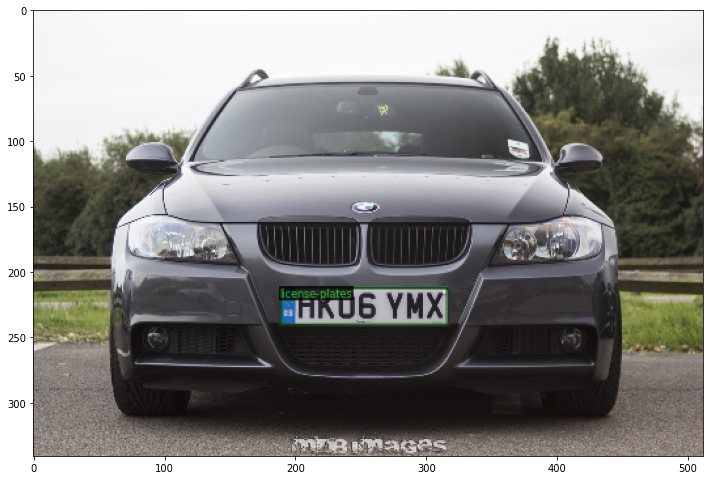

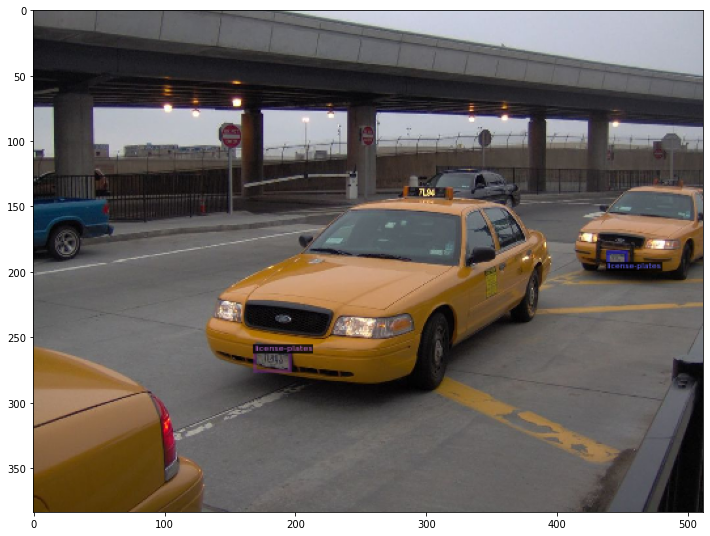

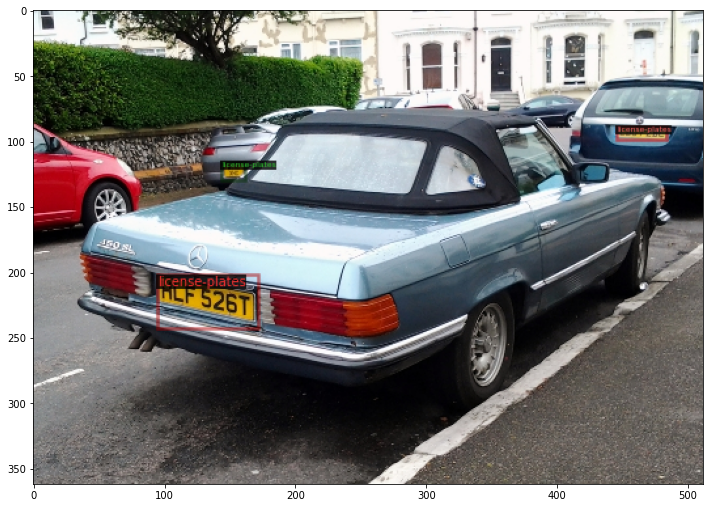

In [24]:
val_data_dict = get_license_plate_dicts(val_data_root)

for d in random.sample(val_data_dict, 3):
  img = cv2.imread(d["file_name"])
  visualizer = Visualizer(img[:,:,::-1],
                          metadata=train_metadata,
                          scale=0.5)
  vis = visualizer.draw_dataset_dict(d)
  plt.figure(figsize = (12,12))
  plt.imshow(vis.get_image())
  plt.show()

#  <font style="color:green">2. Training</font> 

#### Detectron2 Configuration

In [13]:
# Default configuration
cfg = get_cfg()

# Update configuration with RetinaNet configuration
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/retinanet_R_50_FPN_3x.yaml"))

# Replace Detectron2 default trian dataset with our train dataset
cfg.DATASETS.TRAIN = (train_data_name,)

# Update cfg.DATASET.TEST with empty tuple
cfg.DATASETS.TEST = ()


Loading config /usr/local/lib/python3.7/dist-packages/detectron2/model_zoo/configs/COCO-Detection/../Base-RetinaNet.yaml with yaml.unsafe_load. Your machine may be at risk if the file contains malicious content.


In [14]:
# Data loader configuration
cfg.DATALOADER.NUM_WORKERS = 4

In [15]:
# Update model URL in Detectron2 config file
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/retinanet_R_50_FPN_3x.yaml")

##### Solver Configuration

In [17]:
# batch size
cfg.SOLVER.IMS_PER_BATCH = 4

# learning rate
cfg.SOLVER.BASE_LR = 0.001

# define iterations
epoch = 2
max_iter = int(epoch * train_img_count / cfg.SOLVER.IMS_PER_BATCH)
#max_iter = 500

cfg.SOLVER.MAX_ITER = max_iter
print(max_iter)

2663


In [18]:
# number of output class - only one - License Plate
cfg.MODEL.RETINANET.NUM_CLASSES = len(thing_classes)

In [19]:
# update create output directory
cfg.OUTPUT_DIR = output_dir
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

#### Set Up Tensorboard

In [27]:
%load_ext tensorboard

%tensorboard --logdir outputs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 679), started 2:46:14 ago. (Use '!kill 679' to kill it.)

<IPython.core.display.Javascript object>

In [44]:
%reload_ext tensorboard

%tensorboard --logdir outputs

Reusing TensorBoard on port 6006 (pid 679), started 3:41:19 ago. (Use '!kill 679' to kill it.)

<IPython.core.display.Javascript object>

## Tensorboard Experiment:

https://tensorboard.dev/experiment/CoBkEkE1SQOaxJee1qaCww/#scalars

In [43]:
!tensorboard dev upload --logdir ./outputs \
  --name "Project 3 Object Detection" \
  --description "License Plate Detection w/ Detectron2" \
  --one_shot


***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

./outputs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) yes

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=openid+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fuserinfo.email&state=mJLJjs4lQUVBD90q9T1DTHqy3J8sPX&prompt=consent&access_type=offline
Ent

#### Training

In [21]:
# Create a trainer instance with the configuration
trainer = DefaultTrainer(cfg)

# if resume=False, because we don't have trained modelyet.
trainer.resume_or_load(resume=False)

# start training
trainer.train()

Streaming output truncated to the last 5000 lines.
Height: 577, Width: 1024. Filename: 171cf18f57cf0e3a.jpg, Count: 2832
./Dataset/train/Vehicle registration plate/9de855abf6dc972d.jpg
Height: 683, Width: 1024. Filename: 9de855abf6dc972d.jpg, Count: 2833
./Dataset/train/Vehicle registration plate/4080d6d6081fceff.jpg
Height: 768, Width: 1024. Filename: 4080d6d6081fceff.jpg, Count: 2834
./Dataset/train/Vehicle registration plate/1c583f5f87eeca30.jpg
Height: 640, Width: 1024. Filename: 1c583f5f87eeca30.jpg, Count: 2835
./Dataset/train/Vehicle registration plate/828b7a2bf9e52690.jpg
Height: 768, Width: 1024. Filename: 828b7a2bf9e52690.jpg, Count: 2836
./Dataset/train/Vehicle registration plate/047efe4a7f176cca.jpg
Height: 684, Width: 1024. Filename: 047efe4a7f176cca.jpg, Count: 2837
./Dataset/train/Vehicle registration plate/5dfe9be278d26861.jpg
Height: 1024, Width: 768. Filename: 5dfe9be278d26861.jpg, Count: 2838
./Dataset/train/Vehicle registration plate/bda2907a6cc27817.jpg
Height: 768

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
model_final_5bd44e.pkl: 152MB [00:14, 10.6MB/s]                           
Skip loading parameter 'head.cls_score.weight' to the model due to incompatible shapes: (720, 256, 3, 3) in the checkpoint but (9, 256, 3, 3) in the model! You might want to double check if this is expected.
Skip loading parameter 'head.cls_score.bias' to the model due to incompatible shapes: (720,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
head.cls_

[11/22 18:46:32 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[11/22 18:46:54 d2.utils.events]:  eta: 0:49:03  iter: 19  total_loss: 1.313  loss_cls: 0.9465  loss_box_reg: 0.4159  time: 1.1264  data_time: 0.0454  lr: 1.9981e-05  max_mem: 3309M
[11/22 18:47:07 d2.utils.events]:  eta: 0:45:44  iter: 39  total_loss: 1.536  loss_cls: 1.062  loss_box_reg: 0.4742  time: 0.8460  data_time: 0.0322  lr: 3.9961e-05  max_mem: 3309M
[11/22 18:47:17 d2.utils.events]:  eta: 0:24:23  iter: 59  total_loss: 1.335  loss_cls: 0.9298  loss_box_reg: 0.3314  time: 0.7274  data_time: 0.0225  lr: 5.9941e-05  max_mem: 3309M
[11/22 18:47:27 d2.utils.events]:  eta: 0:22:50  iter: 79  total_loss: 1.016  loss_cls: 0.7654  loss_box_reg: 0.2832  time: 0.6712  data_time: 0.0182  lr: 7.9921e-05  max_mem: 3309M
[11/22 18:47:38 d2.utils.events]:  eta: 0:22:41  iter: 99  total_loss: 0.8018  loss_cls: 0.5681  loss_box_reg: 0.2928  time: 0.6416  data_time: 0.0283  lr: 9.9901e-05  max_mem: 3309M
[11/22 18:47:48 d2.utils.events]:  eta: 0:22:20  iter: 119  total_loss: 0.7519  loss_cls: 

#  <font style="color:green">3. Inference</font> 

**You have to make predictions from your trained model on three images from the validation dataset.**

The plotted images should be similar to the following:

<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-p1.png'>



<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-p2.png'>



<img src='https://www.learnopencv.com/wp-content/uploads/2020/04/c3-w10-p3.png'>




In [29]:
# inference on our fine-tuned model

# By default detectron2 save the model with name model_final.pth
# update the model path in configuration that will be used to load the model
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")


# update RetinaNet score threshold 
cfg.MODEL.RETINANET.SCORE_THRESH_TEST = 0.5

cfg.DATASETS.TEST = (val_data_name,)

# create a predictor instance with the configuration (it has our fine-tuned model)
# this predictor does prdiction on a single image
predictor = DefaultPredictor(cfg)

./Dataset/validation/Vehicle registration plate/6846c275ded01f85.jpg
{'instances': Instances(num_instances=1, image_height=1024, image_width=1024, fields=[pred_boxes: Boxes(tensor([[616.2277, 526.9174, 867.6112, 651.6702]], device='cuda:0')), scores: tensor([0.6560], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


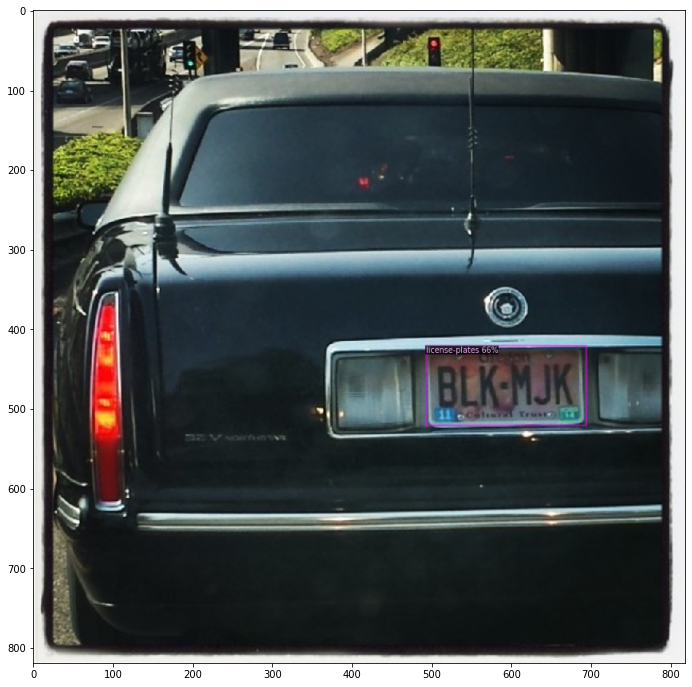

./Dataset/validation/Vehicle registration plate/27798906120ea394.jpg
{'instances': Instances(num_instances=3, image_height=724, image_width=1024, fields=[pred_boxes: Boxes(tensor([[180.6140, 400.3203, 346.9027, 484.8778],
        [891.3699, 177.9257, 966.2171, 197.1682],
        [289.8699, 233.7426, 321.6644, 254.8244]], device='cuda:0')), scores: tensor([0.9159, 0.7635, 0.7608], device='cuda:0'), pred_classes: tensor([0, 0, 0], device='cuda:0')])}


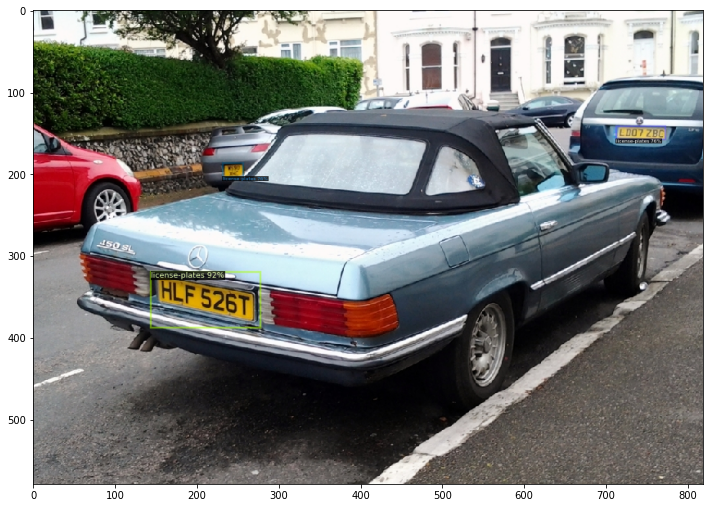

./Dataset/validation/Vehicle registration plate/008637722500f239.jpg
{'instances': Instances(num_instances=2, image_height=768, image_width=1024, fields=[pred_boxes: Boxes(tensor([[817.9381, 252.3293, 873.8712, 282.2318],
        [247.0691, 394.4139, 349.1277, 451.5660]], device='cuda:0')), scores: tensor([0.8307, 0.8052], device='cuda:0'), pred_classes: tensor([0, 0], device='cuda:0')])}


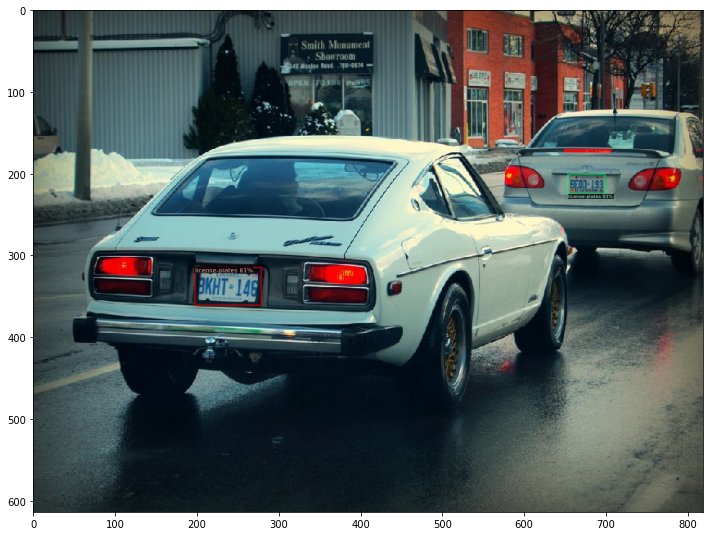

In [30]:
for d in random.sample(val_data_dict, 3):
    print(d["file_name"])
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    print(outputs)
    v = Visualizer(im[:, :, ::-1],
                   metadata=val_metadata, 
                   scale=0.8
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.figure(figsize = (12, 12))
    plt.imshow(v.get_image())
    plt.show()

#  <font style="color:green">4. COCO Detection Evaluation</font> 

**You have to evaluate your detection model on COCO detection evaluation metric.**

For reference here is the coco evaluation metric chart:


---

<img src="https://www.learnopencv.com/wp-content/uploads/2020/03/c3-w9-coco_metric.png">

---

#### <font style="color:red">The expected `AP` (primary challenge metric) is more than `0.5`.</font>

**The expected output should look similar to the following:**

```
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.550
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.886
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.629
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.256
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.653
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.627
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.504
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.629
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.633
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.380
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.722
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.704
```



In [31]:
# create directory for evaluation
eval_dir = os.path.join(cfg.OUTPUT_DIR, 'coco_eval')
os.makedirs(eval_dir, exist_ok=True)

# create evaluator instance with coco evaluator
evaluator = COCOEvaluator(dataset_name=val_data_name, 
                          tasks=cfg, 
                          distributed=False, 
                          output_dir=eval_dir)

# create validation data loader
val_loader = build_detection_test_loader(cfg, val_data_name)

# start validation
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [11/22 19:23:54 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[11/22 19:23:54 d2.evaluation.coco_evaluation]: Trying to convert 'license_plate_validation' to COCO format ...
WARNING [11/22 19:23:54 d2.data.datasets.coco]: Using previously cached COCO format annotations at 'outputs/coco_eval/license_plate_validation_coco_format.json'. You need to clear the cache file if your dataset has been modified.
./Dataset/validation/Vehicle registration plate/f73b754cdb1ab677.jpg
Height: 683, Width: 1024. Filename: f73b754cdb1ab677.jpg, Count: 1
./Dataset/validation/Vehicle registration plate/315aead7766727b8.jpg
Height: 768, Width: 819. Filename: 315aead7766727b8.jpg, Count: 2
./Dataset/validation/Vehicle registration plate/affd16c51644a893.jpg
Height: 768, Width: 1024. Filename: affd16c51644a893.jpg, Count: 3
./Dataset/validation/Vehicle registration plate/c650ff8d3e8e75b3.jpg
Height: 635,

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[11/22 19:24:03 d2.evaluation.evaluator]: Inference done 11/386. Dataloading: 0.0043 s/iter. Inference: 0.0635 s/iter. Eval: 0.0003 s/iter. Total: 0.0681 s/iter. ETA=0:00:25
[11/22 19:24:08 d2.evaluation.evaluator]: Inference done 89/386. Dataloading: 0.0032 s/iter. Inference: 0.0613 s/iter. Eval: 0.0003 s/iter. Total: 0.0649 s/iter. ETA=0:00:19
[11/22 19:24:13 d2.evaluation.evaluator]: Inference done 166/386. Dataloading: 0.0032 s/iter. Inference: 0.0614 s/iter. Eval: 0.0003 s/iter. Total: 0.0651 s/iter. ETA=0:00:14
[11/22 19:24:18 d2.evaluation.evaluator]: Inference done 236/386. Dataloading: 0.0047 s/iter. Inference: 0.0618 s/iter. Eval: 0.0003 s/iter. Total: 0.0670 s/iter. ETA=0:00:10
[11/22 19:24:23 d2.evaluation.evaluator]: Inference done 314/386. Dataloading: 0.0042 s/iter. Inference: 0.0618 s/iter. Eval: 0.0003 s/iter. Total: 0.0664 s/iter. ETA=0:00:04
[11/22 19:24:27 d2.evaluation.evaluator]: Total inference time: 0:00:25.337004 (0.066501 s / iter per device, on 1 devices)
[11

OrderedDict([('bbox',
              {'AP': 57.747133552055395,
               'AP50': 88.16172099481642,
               'AP75': 67.70828579584585,
               'APl': 65.98845871229642,
               'APm': 68.159558016245,
               'APs': 25.562044556902602})])

# <font style="color:green">5. Run Inference on a Video</font>

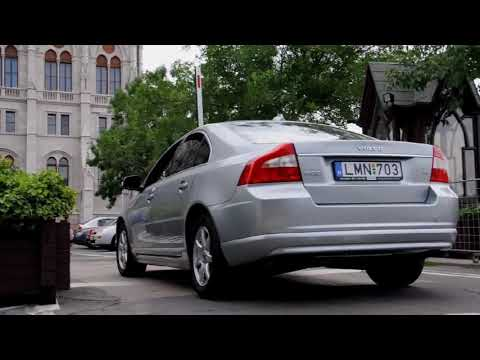

In [ ]:
from IPython.display import YouTubeVideo, display
video = YouTubeVideo("18HWHCevFdU", width=640, height=360)
display(video)

**Your output video should have a bounding box around the vehicle registration plate.**

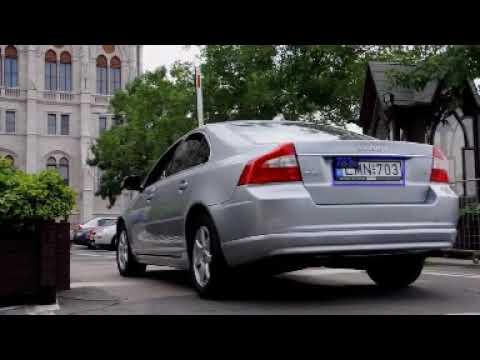

In [ ]:
video = YouTubeVideo("5SgCuee7AMs", width=640, height=360)
display(video)

**You can use the following sample code to read and write a video.**

In [33]:
def video_read_write(video_path):
    """
    Read video frames one-by-one, flip it, and write in the other video.
    video_path (str): path/to/video
    """
    video = cv2.VideoCapture(video_path)

    output_frames = []
    
    # Check if camera opened successfully
    if not video.isOpened(): 
        print("Error opening video file")
        return
    
    # create video writer
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
    frames_per_second = video.get(cv2.CAP_PROP_FPS)
    num_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    
    output_fname = '{}_out.mp4'.format(os.path.splitext(video_path)[0])
    
    output_file = cv2.VideoWriter(
        filename=output_fname,
        # some installation of opencv may not support x264 (due to its license),
        # you can try other format (e.g. MPEG)
        fourcc=cv2.VideoWriter_fourcc(*"mp4v"), # x264
        fps=float(frames_per_second),
        frameSize=(width, height),
        isColor=True,
    )
        
    i = 0
    while video.isOpened():
        ret, frame = video.read()
        if ret:
            #im = cv2.imread(frame)
            outputs = predictor(frame)
            #print(outputs)
            v = Visualizer(frame[:,:,::-1],
                          metadata=val_metadata,
                          scale=1)
            v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
            plt.imshow(v.get_image())
            plt.show()
            output_frames.append(v.get_image()[:,:,::-1]) # changed 'write' to 'append'
#             cv2.imwrite('anpd_out/frame_{}.png'.format(str(i).zfill(3)), frame[:, ::-1, :])
            i += 1
        else:
            break


    for i in range(len(output_frames)):
        output_file.write(output_frames[i])

    video.release()
    output_file.release()
    
    return 

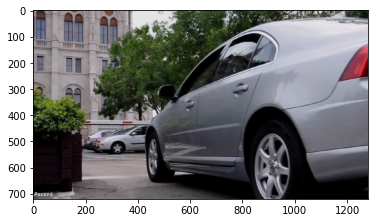

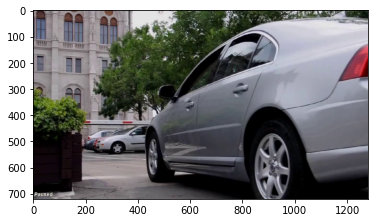

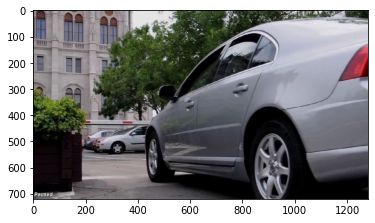

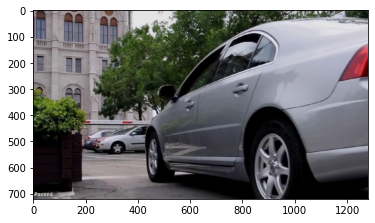

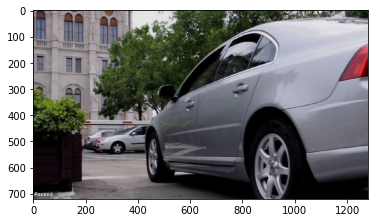

...

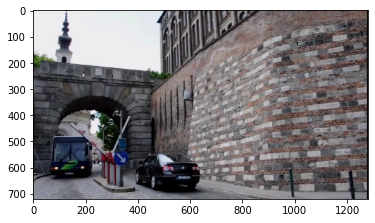

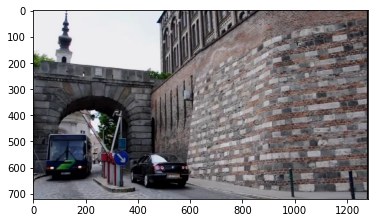

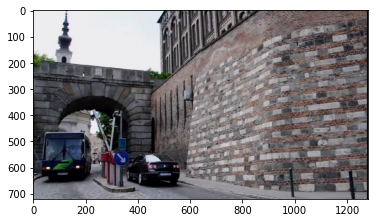

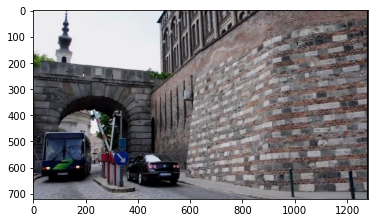

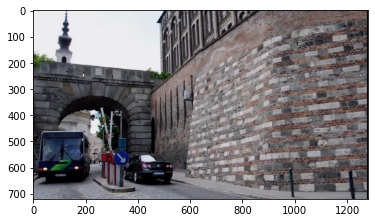

In [34]:
video_read_write('project3-input-video.mp4')

### Video Link:

https://youtu.be/KfyDvN3TSpI